## Cell Segmentation Project

This notebook showcases an attempt at taking samples from our merFISH experiments and applying cell segmentation techniques in order to properly separate cells and extract data.

In [1]:
%matplotlib notebook

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

import pandas as pd

import skimage.data as data
import skimage.segmentation as seg
import skimage.filters as filters
import skimage.draw as draw
import skimage.color as color

from scipy import ndimage as ndi

from skimage import data
from skimage import io
from skimage import img_as_float, img_as_ubyte, segmentation

from skimage.feature import peak_local_max
from skimage.measure import regionprops, label

In [3]:
#source code from scikit image

def difference_of_gaussians(image, low_sigma, high_sigma=None, *,
                            mode='nearest', cval=0, multichannel=False,
                            truncate=4.0):

    image = img_as_float(image)
    low_sigma = np.array(low_sigma, dtype='float', ndmin=1)
    if high_sigma is None:
        high_sigma = low_sigma * 1.6
    else:
        high_sigma = np.array(high_sigma, dtype='float', ndmin=1)

    if multichannel is True:
        spatial_dims = image.ndim - 1
    else:
        spatial_dims = image.ndim

    if len(low_sigma) != 1 and len(low_sigma) != spatial_dims:
        raise ValueError('low_sigma must have length equal to number of'
                         ' spatial dimensions of input')
    if len(high_sigma) != 1 and len(high_sigma) != spatial_dims:
        raise ValueError('high_sigma must have length equal to number of'
                         ' spatial dimensions of input')

    low_sigma = low_sigma * np.ones(spatial_dims)
    high_sigma = high_sigma * np.ones(spatial_dims)

    if any(high_sigma < low_sigma):
        raise ValueError('high_sigma must be equal to or larger than'
                         'low_sigma for all axes')

    im1 = filters.gaussian(image, low_sigma, mode=mode, cval=cval,
                   multichannel=multichannel, truncate=truncate)

    im2 = filters.gaussian(image, high_sigma, mode=mode, cval=cval,
                   multichannel=multichannel, truncate=truncate)

    return im1 - im2

In [33]:
#input image

'''
The original image was a 20000 x 21000 pixel file, so in order 
to make the process go by faster, the central portion was cropped out
resulting in the file being imported here
'''

img = img_as_float(io.imread('C:/Users/jv92c/Documents/mFISH/sample_data/DAPI_Overview_cropped.tif'))

In [5]:
"""
========================
Preprocessing of images
========================

Even though the image is already cropped, a 10000 X 11000 file is still rather unwieldy,
which is why in the following processes, the sample is indexed so that only a 4000 x 4000 portion
will be used.

To begin, a gaussian filter will be applied in order to smooth the image and produce objects
where the brightest areas are used as peaks for further processes

Initially, an unadjusted gaussian was applied to limited results, so as a comparison, another
mask was made, but with sigma adjusted to 40

"""

#application of the gaussian filter, with sigma set to default
img_gaussian_original = filters.gaussian(img[0:4000,4000:8000], sigma=1, 
                        output=None, mode='nearest',cval=0, multichannel=None, preserve_range=False, truncate=4.0)

#gaussian, but with an adjusted sigma
img_gaussian_adjusted = filters.gaussian(img[0:4000,4000:8000], sigma=40, 
                        output=None, mode='nearest',cval=0, multichannel=None, preserve_range=False, truncate=4.0)

<IPython.core.display.Javascript object>


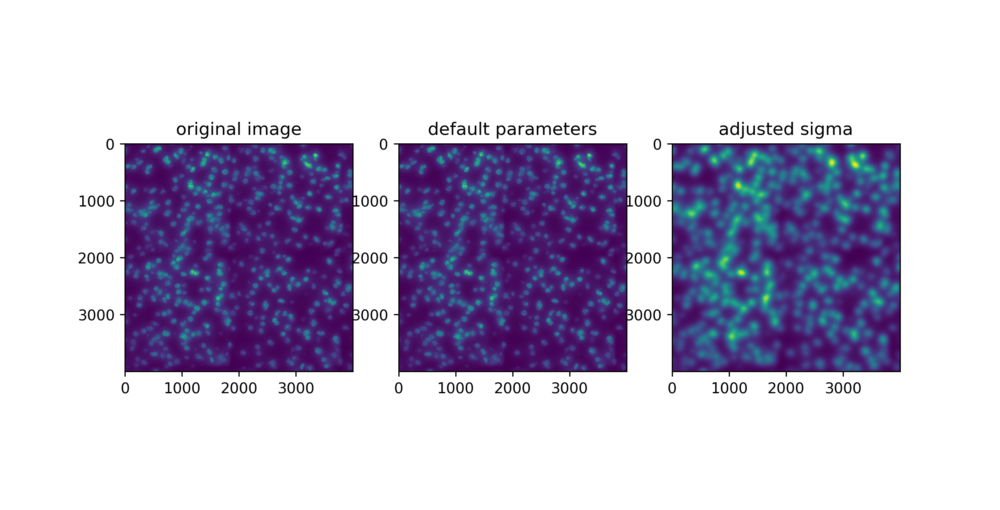

In [6]:
fig, ax = plt.subplots(ncols=3)
ax[0].imshow(img[0:4000, 4000:8000])
ax[0].set_title('original image')
ax[1].imshow(img_gaussian_original)
ax[1].set_title('default parameters')
ax[2].imshow(img_gaussian_adjusted)
ax[2].set_title('adjusted sigma')

plt.show()

In [7]:
"""
Next, a high-sigma mask is made, which is then subtracted from the low-sigma counterparts.
This is done in order to make the fluorescence and background uniform, to eliminate 
checkerboarding in the images, and to facilitate the watershed.
"""

#applying high-pass gaussian for image subtraction
img_gaussian_mask = filters.gaussian(img[0:4000, 4000:8000], sigma=150, 
                                     output=None, mode='nearest', cval=0, 
                                     multichannel=None, preserve_range=False, truncate=4.0)

img_subtracted = img_gaussian_original - img_gaussian_mask
img_filtered = img_gaussian_adjusted - img_gaussian_mask

<IPython.core.display.Javascript object>


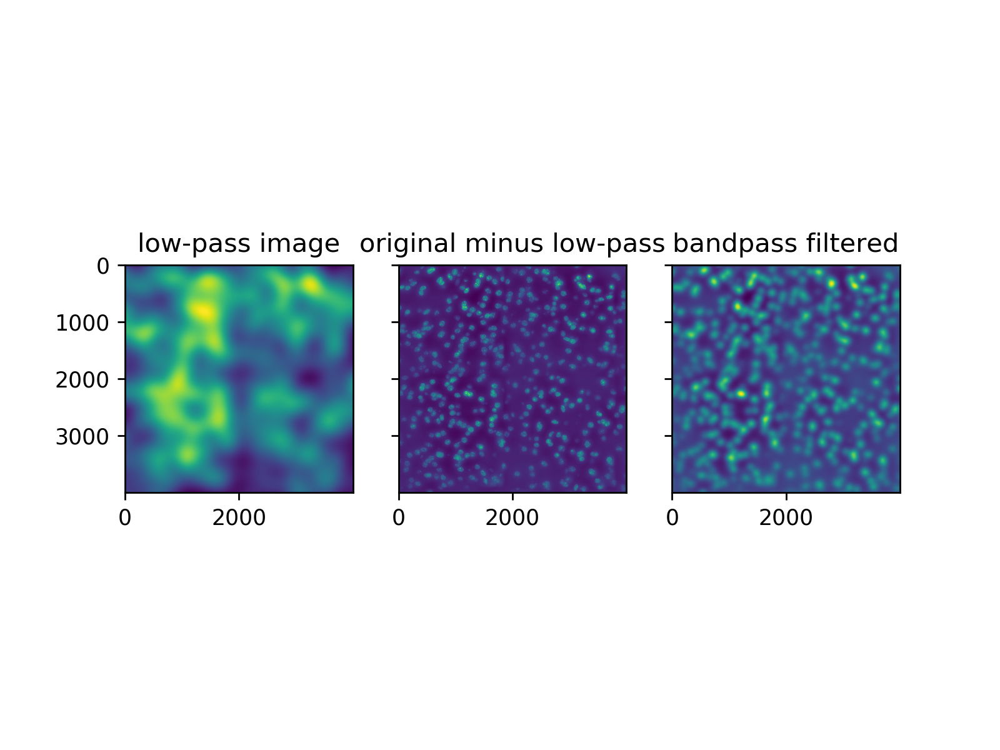

In [8]:
fig, ax = plt.subplots(ncols=3, sharey=True)
ax[0].imshow(img_gaussian_mask)
ax[0].set_title('low-pass image')
ax[1].imshow(img_subtracted)
ax[1].set_title('original minus low-pass')
ax[2].imshow(img_filtered)
ax[2].set_title('bandpass filtered')

plt.show()

In [9]:
"""
But before the watershed can be applied, here we create a mask by thresholding
the gaussian-treated image by means of the otsu threshold. Here, we have three variants:

original : gaussian with default parameters, no subtraction
subtracted : difference of gaussians, default - sigma:150, subtracting a low-pass image
filtered : difference of gaussians, sigma:40 - sigma:150, resulting in a bandpass filtered image
"""

#threshold image by otsu thresholding, outputs a binary image (bool)
threshold_original = img_gaussian_original > filters.threshold_otsu(img_gaussian_original)*0.87
threshold_subtracted = img_subtracted > filters.threshold_otsu(img_subtracted)*0.87
threshold_filtered = img_filtered > filters.threshold_otsu(img_filtered)*0.87

#then label image in preparation for regionprops
labeled_img_original = label(threshold_original)
labeled_img_subtracted = label(threshold_subtracted)
labeled_img_filtered = label(threshold_filtered)

<IPython.core.display.Javascript object>


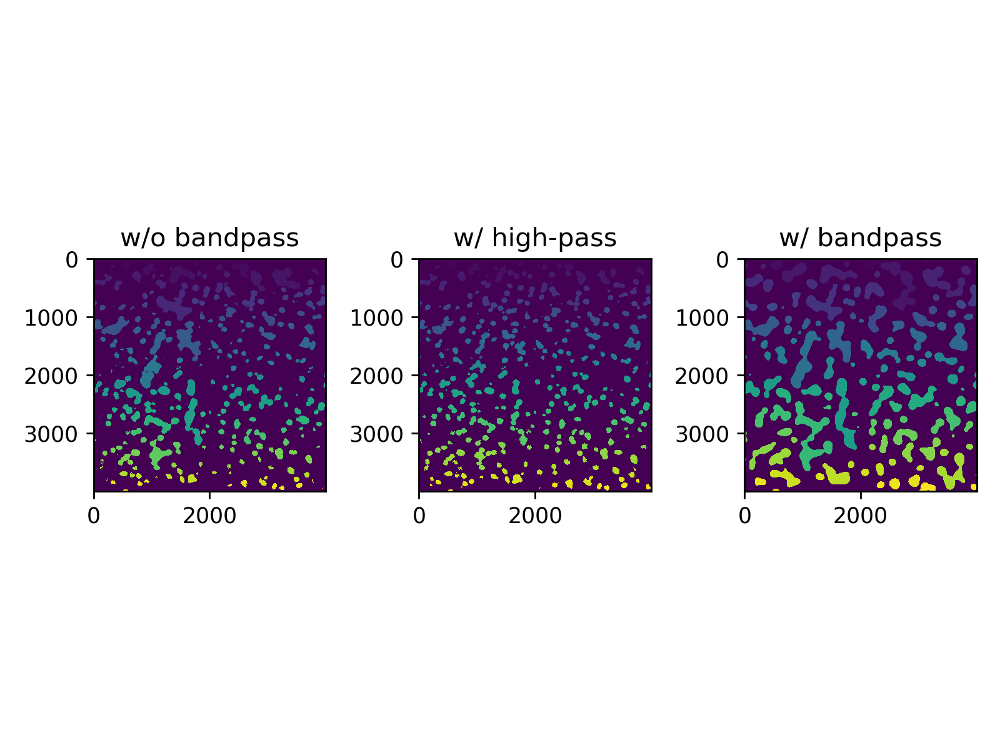

In [10]:
fig, ax = plt.subplots(ncols=3)
ax[0].imshow(labeled_img_original)
ax[0].set_title('w/o bandpass')
ax[1].imshow(labeled_img_subtracted)
ax[1].set_title('w/ high-pass')
ax[2].imshow(labeled_img_filtered)
ax[2].set_title('w/ bandpass')

plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


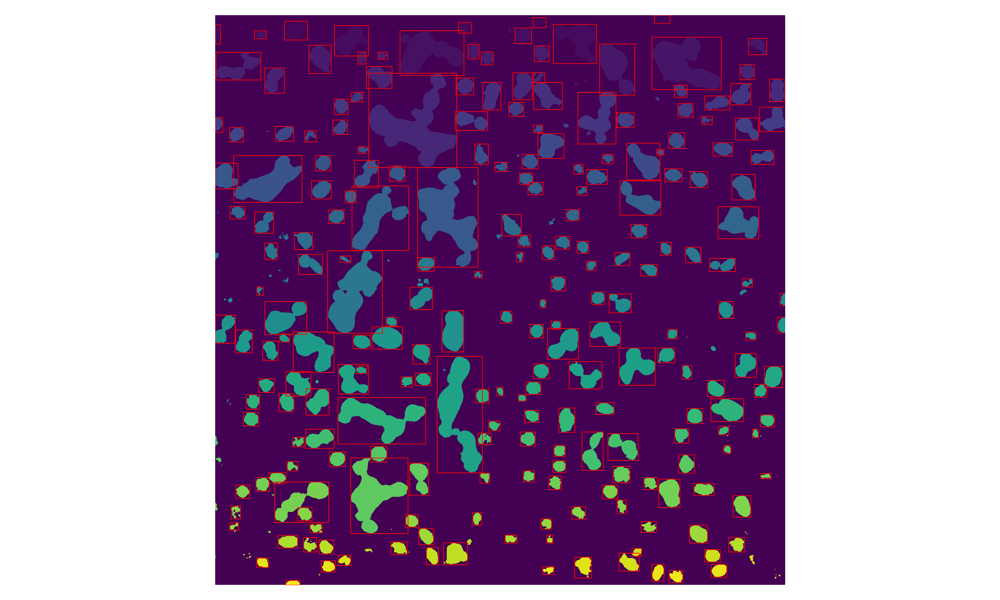

,index,mean_intensity,area,eccentricity,diameter
0,3,0.111714,4511,0.804901,75.786434
1,4,0.102224,4084,0.771230,72.110404
2,6,0.187774,15164,0.738037,138.951087
3,8,0.107777,5327,0.618776,82.356220
4,10,0.140542,43412,0.790836,235.103967
...,...,...,...,...,...
223,336,0.124648,7507,0.633733,97.766095
224,337,0.130574,6654,0.795087,92.044206
225,339,0.094297,2337,0.823530,54.548701
226,341,0.105478,5599,0.563223,84.432625


In [11]:
"""
===========
Regionprops
===========

Now that we have a labeled image, we can now begin processing through regionprops.
First, we plot the image, and initialize an empty list. This list will serve as
the foundation of a pandas dataframe that we will generate.

Next, we utilize a for loop to then draw a rectangle around a labled region 
that meets area qualifications. At the same time, for each of those regions,
data such as their mean intensity, area, eccentricity/circularity, and a
measure of a diameter spanned by an equivalent circle is added to a dictionary,
and every dictionary that is generated is then appended to the empty list that was
initialized prior to executing the for loop.

source of regionprops for loop:
"https://scikit-image.org/docs/dev/auto_examples/segmentation/
plot_label.html#sphx-glr-auto-examples-segmentation-plot-label-py"


the area parameter was determined by running the for loop initally without any area 
constraints, and then plotting the subsequent data on a histogram. By continously
narrowing the range, the value of 1200 pixel area was selected based on a brute-force
adjustment, while observing the frequencies of the values below it.

"""

##extracting data from non-filtered image###

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_img_original)

region_info = []

for region in regionprops(labeled_img_original, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        
        #create a list of dictionaries where keys/values are regionprops properties
        region_data = dict(index = region.label,
                           mean_intensity = region.mean_intensity,
                           area = region.area,
                           eccentricity = region.eccentricity,
                           diameter = region.equivalent_diameter)
                           
        region_info.append(region_data)

ax.set_axis_off()
plt.tight_layout()
plt.show()

#convert dictionary into a pandas dataframe
region_data = pd.DataFrame.from_records(region_info)
region_data

#### Preliminary results

As one can observe, there's still a lot to be desired from the processing method. There are debris that are being mislabeled, and there is severe overlap over cell clusters. Underdetection is also present, as there are some cells that are misrepresented
as small fragments, since the DAPI intensity seems to be lower in some nuclei.

The image below overlays the identified regions over the original data.

<IPython.core.display.Javascript object>


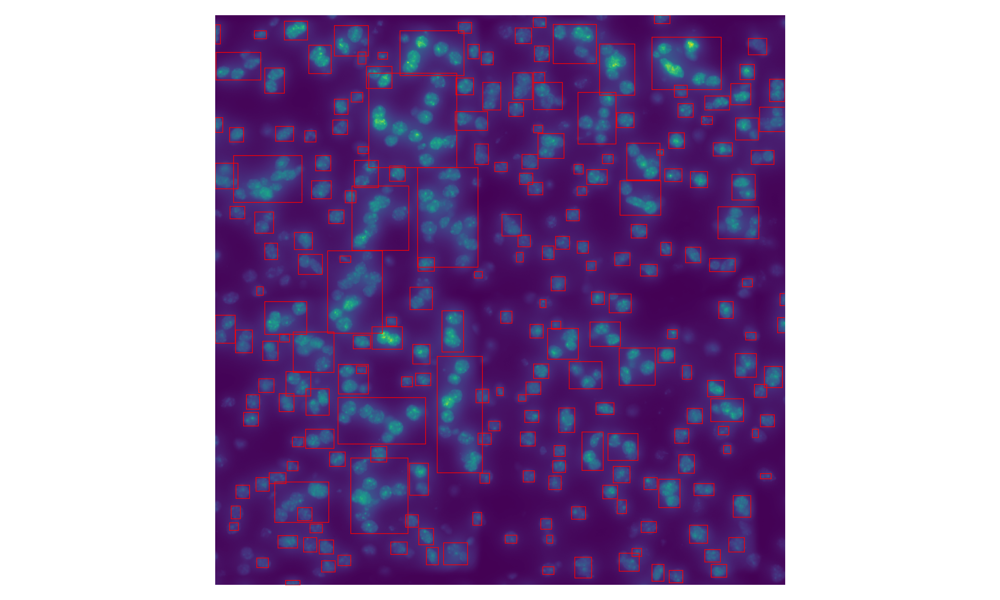

In [12]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_img_original)

for region in regionprops(labeled_img_original, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)

ax.set_axis_off()

plt.imshow(img[0:4000,4000:8000])
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


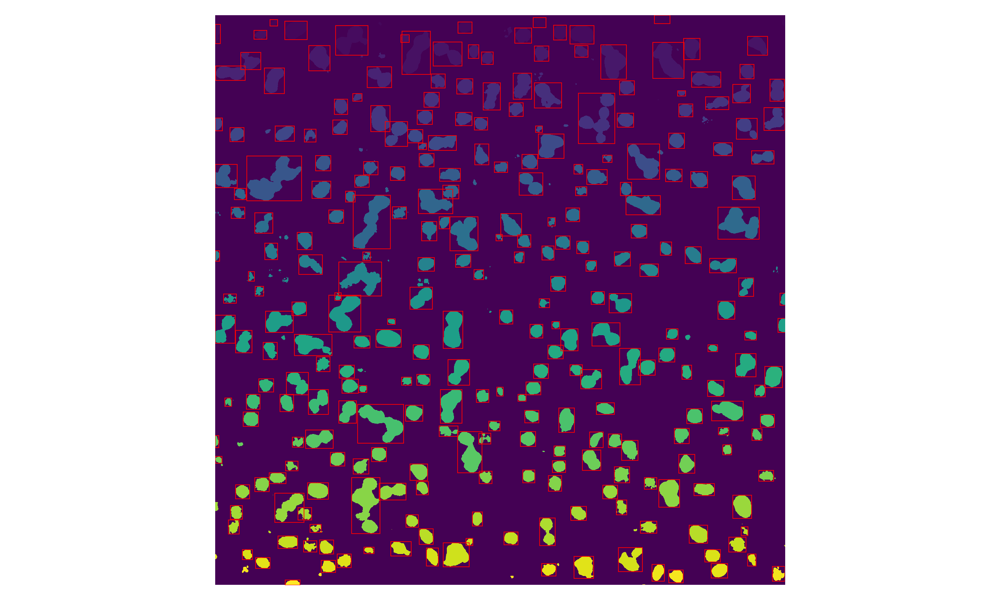

,index,mean_intensity,area,eccentricity,diameter
0,3,0.112325,4422,0.810752,75.035094
1,4,0.103617,3840,0.792854,69.923100
2,6,0.080057,1475,0.856819,43.336224
3,7,0.191280,14673,0.745061,136.683005
4,8,0.104702,5858,0.621045,86.363402
...,...,...,...,...,...
275,384,0.077062,6076,0.592767,87.955690
276,387,0.128427,6930,0.787091,93.933753
277,390,0.062992,5392,0.570897,82.857152
278,392,0.101068,6565,0.467313,91.426570


In [13]:
"""
Next, we attempt regionprops on the _subtracted image to see
if there is any improvement in detection
"""

#extracting data from original image subtracted by an unadjusted gaussian mask
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_img_subtracted)

region_info = []

for region in regionprops(labeled_img_subtracted, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        
        #create a list of dictionaries where keys/values are regionprops properties
        region_data = dict(index = region.label,
                           mean_intensity = region.mean_intensity,
                           area = region.area,
                           eccentricity = region.eccentricity,
                           diameter = region.equivalent_diameter)
                           
        region_info.append(region_data)

ax.set_axis_off()
plt.tight_layout()
plt.show()

#convert dictionary into a pandas dataframe
region_data_subtracted = pd.DataFrame.from_records(region_info)
region_data_subtracted

<IPython.core.display.Javascript object>


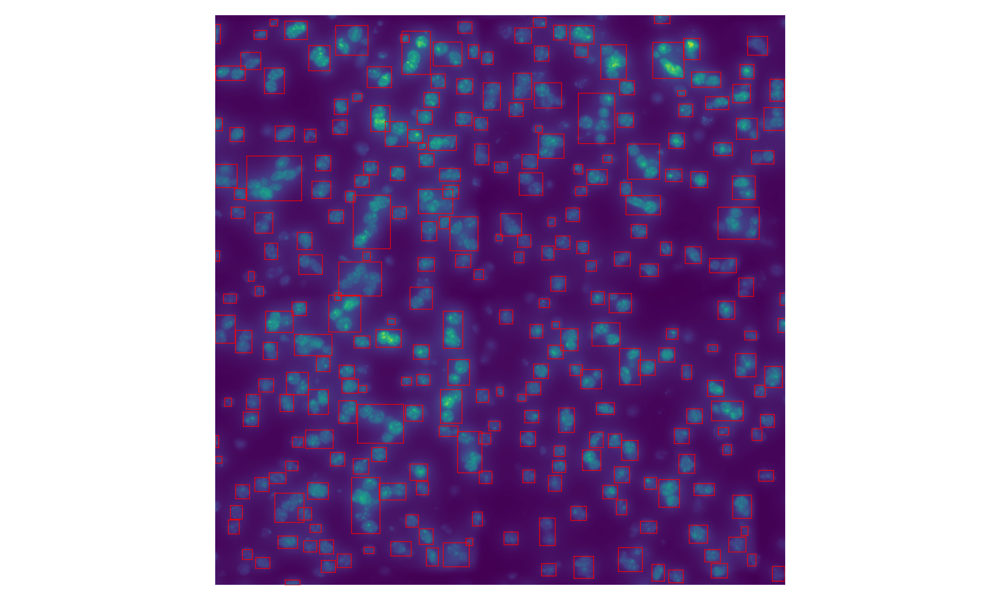

In [14]:
#extracting data from original image subtracted by an unadjusted gaussian mask
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_img_subtracted)

for region in regionprops(labeled_img_subtracted, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)


ax.set_axis_off()

plt.imshow(img[0:4000,4000:8000])
plt.tight_layout()
plt.show()

For this run, there is great improvement for cell detection, as some of the clusters, and even
what was previously seen as small debris/fragments have been correctly identified as individual 
cells. Some clusters are still not being properly delineated, but this is still much better.

<IPython.core.display.Javascript object>


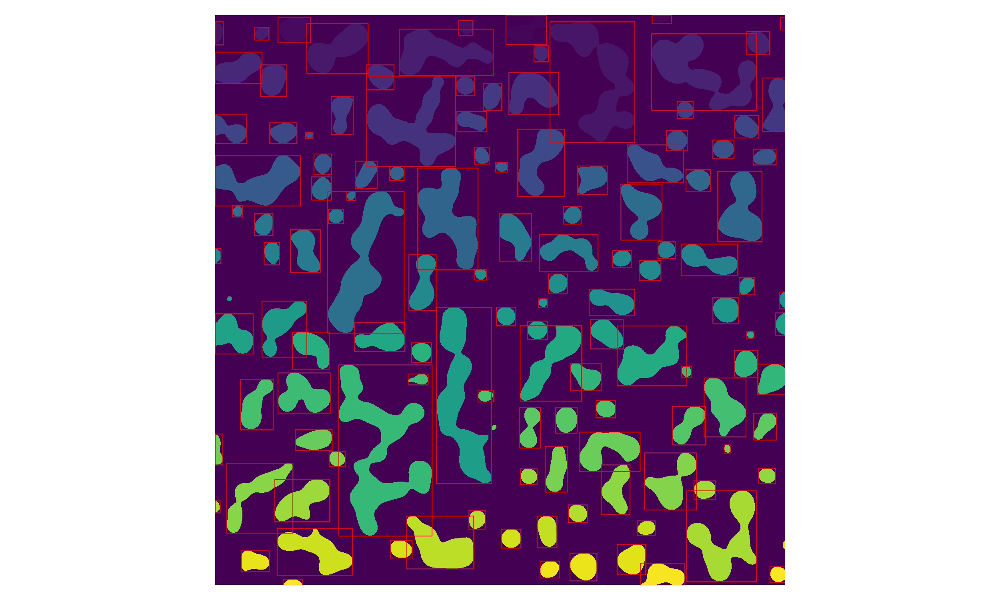

,index,mean_intensity,area,eccentricity,diameter
0,2,0.082205,28087,0.900423,189.107057
1,3,0.102548,5516,0.886821,83.804471
2,4,0.119366,31371,0.614157,199.856943
3,5,0.053406,2016,0.910989,50.664099
4,6,0.092082,8124,0.303254,101.704464
...,...,...,...,...,...
121,126,0.067822,27944,0.388704,188.625040
122,127,0.058719,12246,0.564496,124.868296
123,128,0.077865,32162,0.859686,202.360891
124,129,0.053214,9505,0.330638,110.009735


In [15]:
#data from a filtered image
#where a high-pass image was subtracted from a low-pass image

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_img_filtered)

region_info = []

for region in regionprops(labeled_img_filtered, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        
        #create a list of dictionaries where keys/values are regionprops properties
        region_data = dict(index = region.label,
                           mean_intensity = region.mean_intensity,
                           area = region.area,
                           eccentricity = region.eccentricity,
                           diameter = region.equivalent_diameter)
                           
        region_info.append(region_data)

ax.set_axis_off()
plt.tight_layout()
plt.show()

#convert dictionary into a pandas dataframe
region_data_filtered = pd.DataFrame.from_records(region_info)
region_data_filtered

<IPython.core.display.Javascript object>


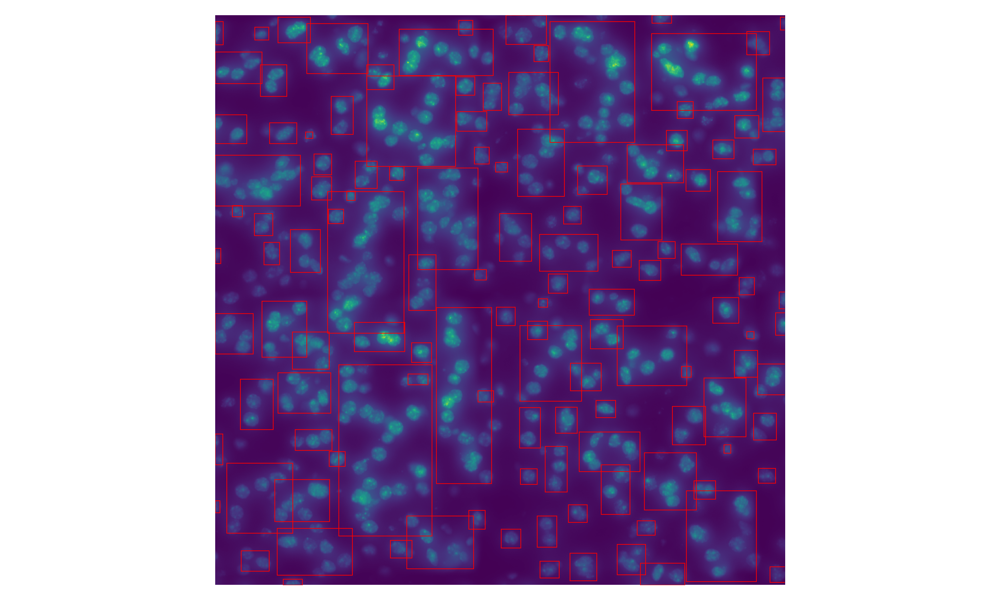

In [16]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_img_filtered)

for region in regionprops(labeled_img_filtered, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)

ax.set_axis_off()
plt.imshow(img[0:4000, 4000:8000])
plt.tight_layout()
plt.show()

This last application sees a bandpass filtered image taken through regionprops. For many of the smaller cells, detection seems to be much better than the previous two, and many of the miscellaneous fragments are removed from the image. However, it has a much higher tendency to group together cells, even though there is ample space between them, as shown in the overlay. But this could simply be a result of poor optimization, and with better sigmas, this might be mitigated. 

## Applying watershed to non-filtered image

To help de-cluster the cells, we will now use the watershed technique to try and divide the larger objects. The goal is to process the images right before the labeling step, and then proceed to regionprops. First, we will try with the _original_ variant of image

<IPython.core.display.Javascript object>


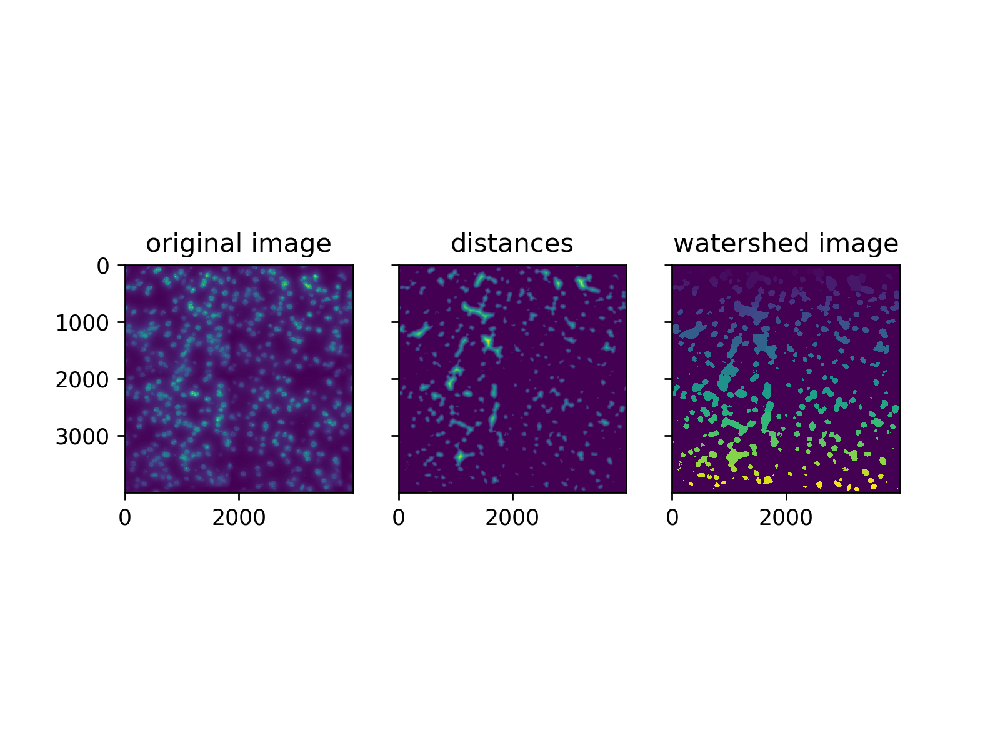

Text(0.5, 1.0, 'watershed image')

In [17]:
# Generate the markers as local maxima of the distance to the background
distance = ndi.distance_transform_edt(threshold_original)
local_maxi = peak_local_max(distance, indices=False, footprint=np.ones((20, 20)),labels=threshold_original)
markers = ndi.label(local_maxi)[0]
watershed_original = seg.watershed(-distance, markers, mask=threshold_original)

fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True)
ax[0].imshow(img[0:4000, 4000:8000])
ax[0].set_title('original image')
ax[1].imshow(distance)
ax[1].set_title('distances')
ax[2].imshow(watershed_original)
ax[2].set_title('watershed image')

<IPython.core.display.Javascript object>


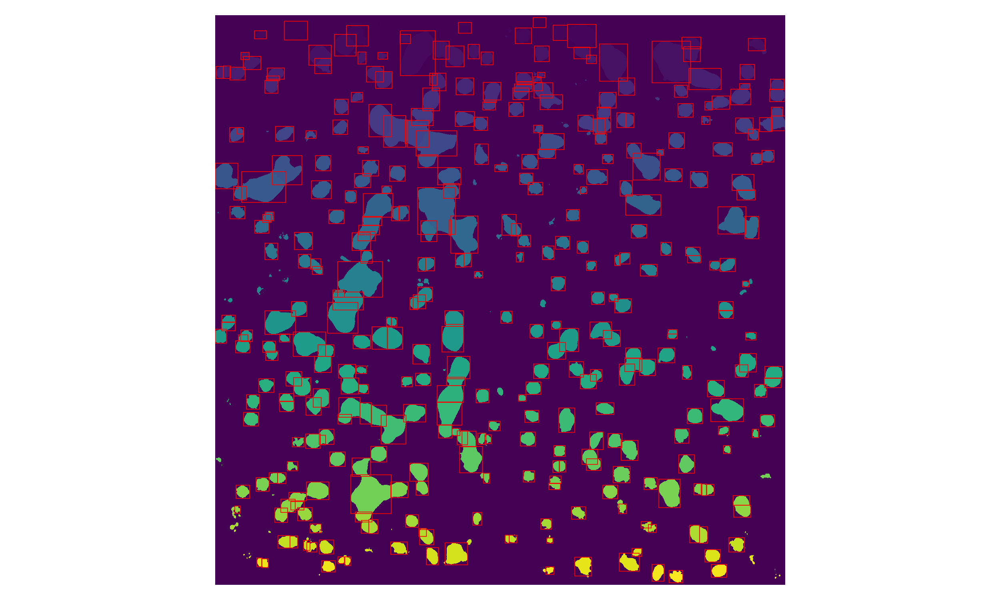

In [18]:
label_ws_org = label(watershed_original)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(label_ws_org)

for region in regionprops(label_ws_org, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        

ax.set_axis_off()
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


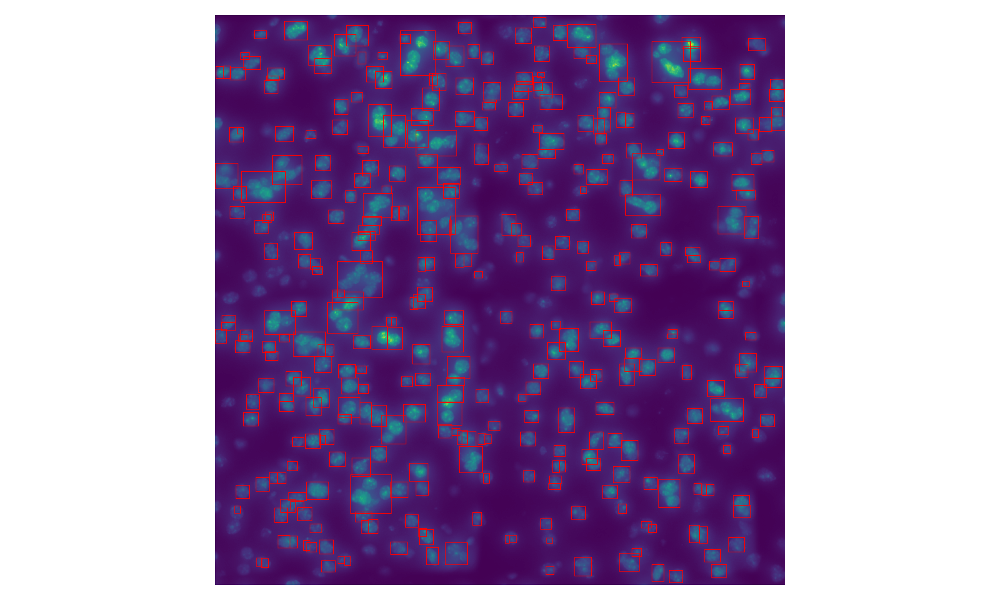

In [19]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(img[0:4000,4000:8000])

for region in regionprops(label_ws_org, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        

ax.set_axis_off()
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


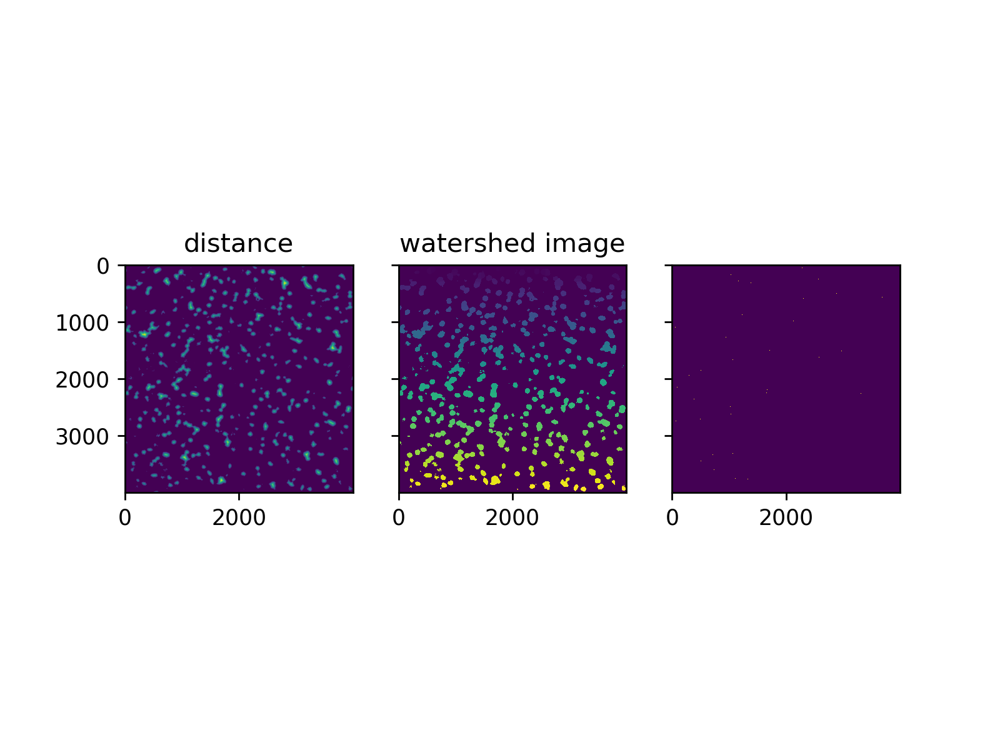

In [20]:
# markers by method of subtracting high-pass

distance = ndi.distance_transform_edt(threshold_subtracted)
local_maxi = peak_local_max(distance, indices=False, footprint=np.ones((3, 3)),labels=threshold_subtracted)
markers = ndi.label(local_maxi)[0]
watershed_subtracted = seg.watershed(-distance, markers, mask=threshold_subtracted)

fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True)
ax[0].imshow(distance)
ax[0].set_title('distance')
ax[1].imshow(watershed_subtracted)
ax[1].set_title('watershed image')
ax[2].imshow(local_maxi)

<IPython.core.display.Javascript object>


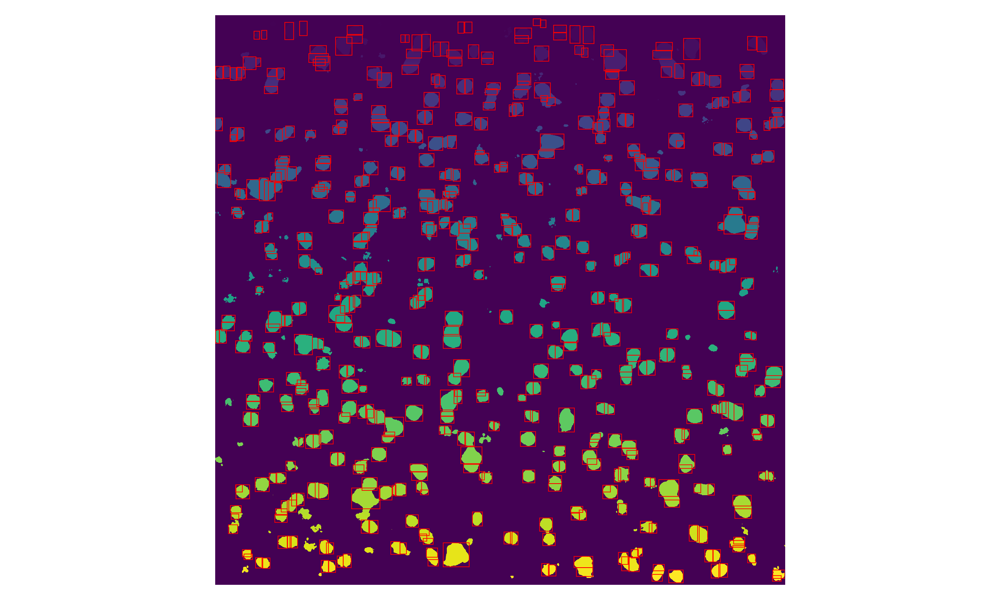

In [21]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(watershed_subtracted)

for region in regionprops(watershed_subtracted, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        

ax.set_axis_off()
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


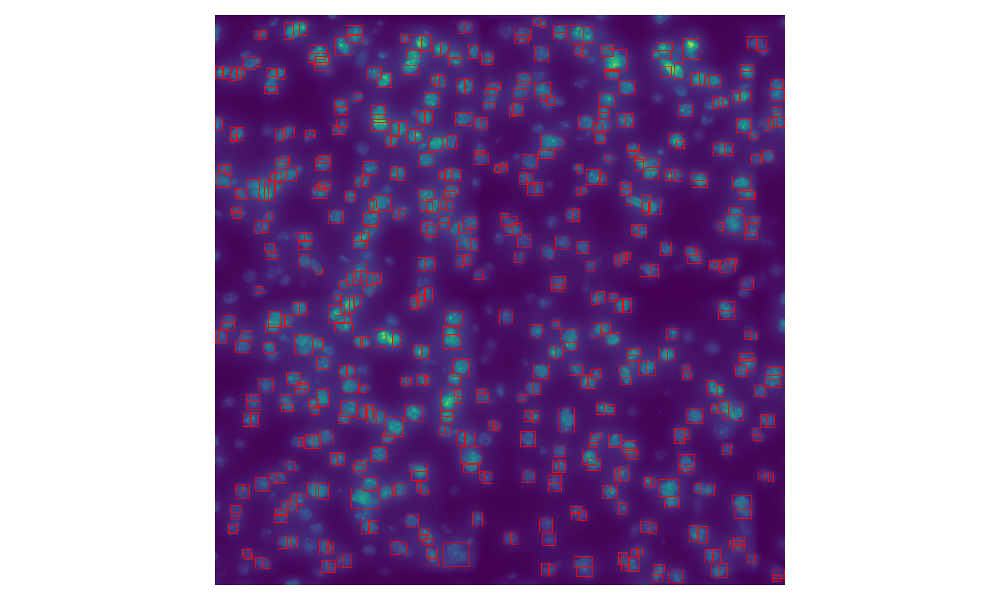

In [22]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(img[0:4000,4000:8000])

for region in regionprops(watershed_subtracted, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        

ax.set_axis_off()
plt.tight_layout()
plt.show()

So now, we face this issue of oversegmentation. What was once a single cell is now being subdivided into two or even three objects. While this might be fine in some cases (for example, where overall intensity is the only value of interest), this is infeasible for the end goal of properly identifying individual cells. Though it might not be possible to completely capture every individual nuclei, the current error rate is simply unacceptible, and may be encroaching upon the limits of this technique. Strong signal from multiple wavelengths will only exacerbate this issue, so perhaps the compatibility between analysis and experimental technique may have been poor.

Nevertheless, we will attempt one more watershed, but this time with different sigma values.

<IPython.core.display.Javascript object>


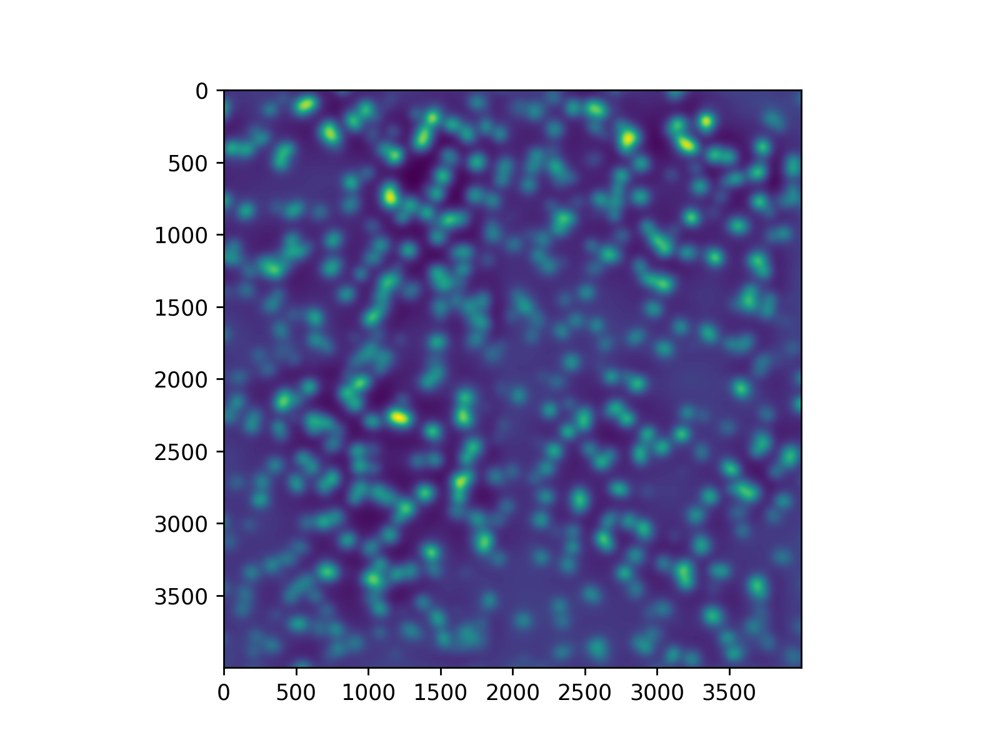

In [23]:
img_gaussian_30s = filters.gaussian(img[0:4000, 4000:8000], sigma=30, output=None, mode='nearest',
                                cval=0, multichannel=None, preserve_range=False, truncate=4.0)

img_gaussian_120s = filters.gaussian(img[0:4000, 4000:8000], sigma=120, output=None, mode='nearest',
                                cval=0, multichannel=None, preserve_range=False, truncate=4.0)

img_sub30 = img_gaussian_30s - img_gaussian_120s

plt.figure()
plt.imshow(img_sub30)

<IPython.core.display.Javascript object>


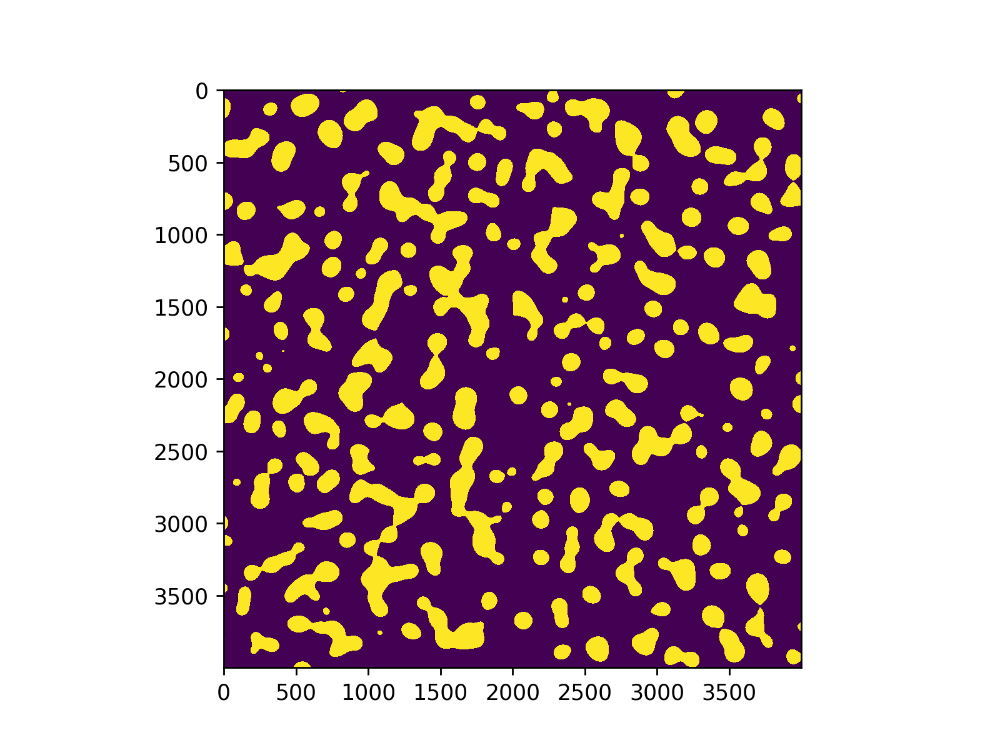

In [24]:
threshold_sub30 = img_sub30 > filters.threshold_otsu(img_sub30)*0.87

plt.figure()
plt.imshow(threshold_sub30)

<IPython.core.display.Javascript object>


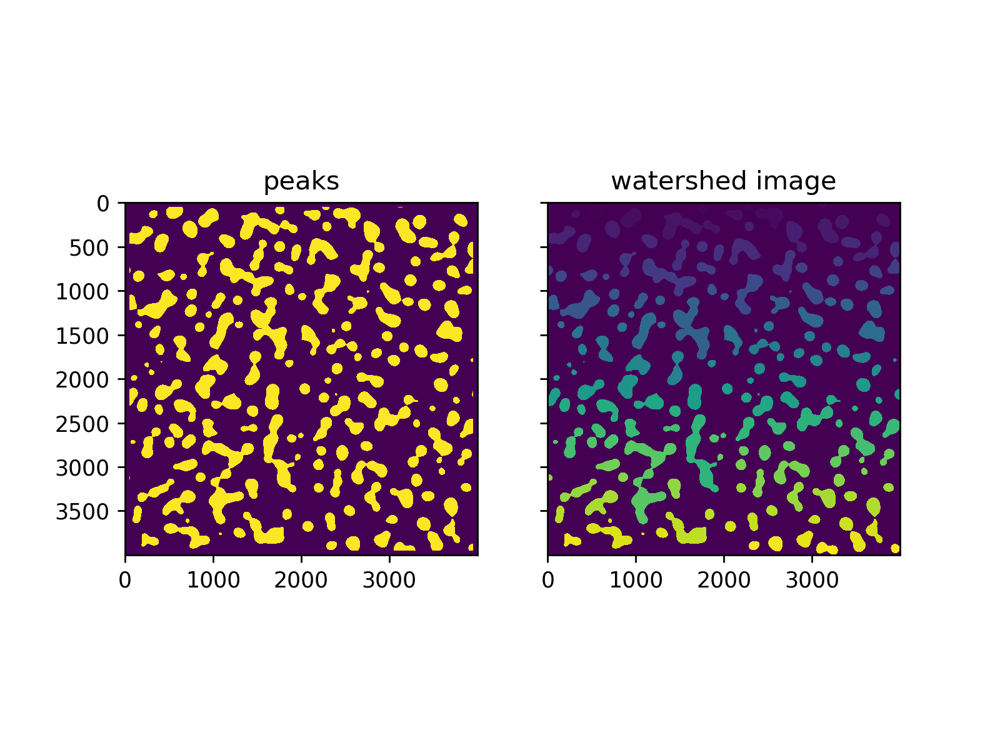

Text(0.5, 1.0, 'watershed image')

In [31]:
#for this particular watershed, instead of using a distance transform, we will be using a binary image
#in our peak local max function
peaks = peak_local_max(threshold_sub30, indices=False, footprint=np.ones((20, 20)), labels=threshold_sub30)
markers = ndi.label(peaks)[0]
watershed_sub30 = seg.watershed(-distance, markers, mask=threshold_sub30)

fig, ax = plt.subplots(ncols=2, sharex=True, sharey=True)
ax[0].imshow(peaks)
ax[0].set_title('peaks')
ax[1].imshow(watershed_sub30)
ax[1].set_title('watershed image')


<IPython.core.display.Javascript object>


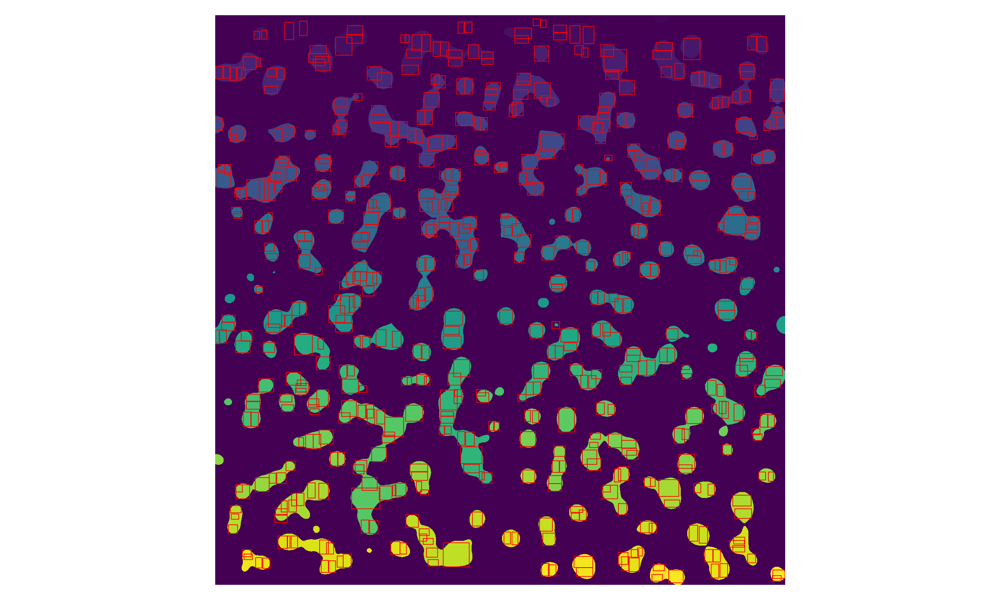

In [32]:
labeled_sub30 = label(watershed_sub30)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(labeled_sub30)

for region in regionprops(watershed_subtracted, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        

ax.set_axis_off()
plt.tight_layout()
plt.show()

C:\Users\jv92c\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


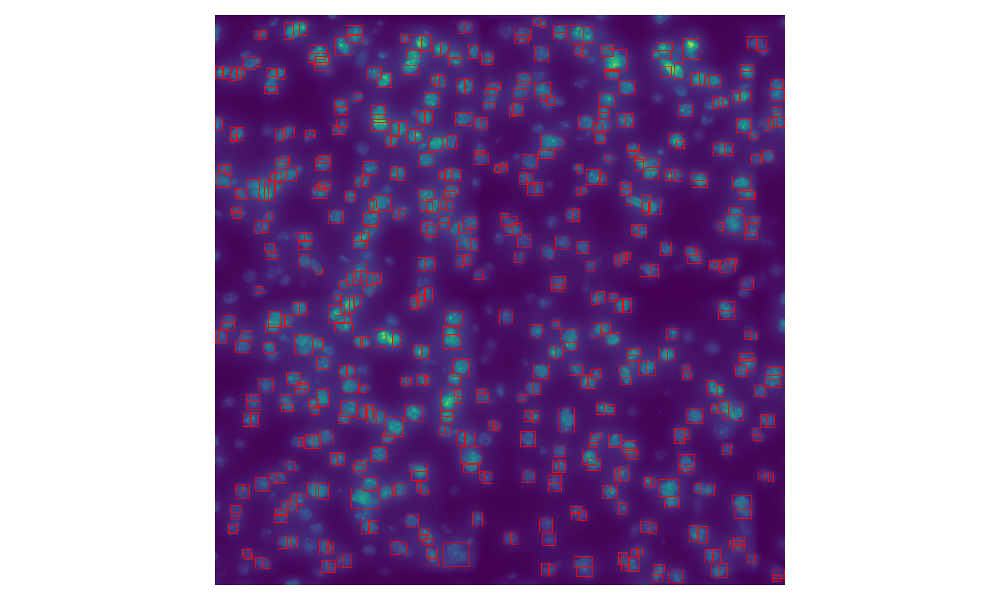

In [30]:
labeled_sub30 = label(watershed_sub30)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(img[0:4000,4000:8000])

for region in regionprops(watershed_subtracted, intensity_image=img[0:4000,4000:8000]):
    
    #take regions with large enough areas, attempts to exclude partial nuclei
    if region.area >= 1200:
        
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=0.5)
        ax.add_patch(rect)
        

ax.set_axis_off()
plt.tight_layout()
plt.show()

### Intensity vs. Area

Most of the segmented nuclei are in the 400 - ~18000 pixel range, while intensity for the majority of the cells peak just below 0.18. However, as most cells overlap, with no watershedding applied, these values are expected to change, and reign in some of the more egregious outliers. I expect the new numbers to run between 400 - 1200, with the outliers going no further than 5000 pixels.

### Eccentricity

One of the original goals was to see the distribution of cells across varying levels of eccentricity. The scale goes from 0 to 1, where 0 is a perfect circle, and 1 is a parabola. This may not be the most accurate of metrics, due to the highly organic shape of nuclei. 

<IPython.core.display.Javascript object>


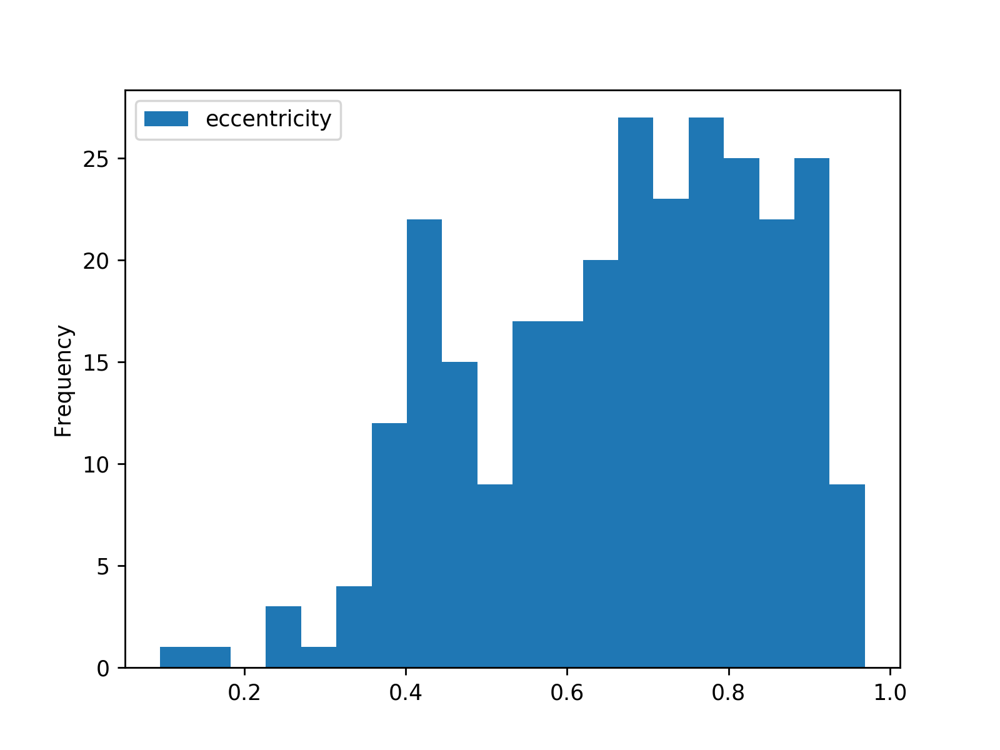

In [35]:
eccentric = pd.DataFrame(region_data_subtracted, columns=['eccentricity'])

eccentric.plot.hist(bins=20)

In [ ]:
###The active contour way (a sidenote)###


#generate a circle around a nucleus
s = np.linspace(0, 2*np.pi, 400)

#set size and coordinates of the circle
r = 75 + 25*np.sin(s)
c = 255 + 25*np.cos(s)


init = np.array([r, c]).T

snake = seg.active_contour(img_threshold,
                       init, alpha=0.015, beta=10, gamma=0.001,
                       coordinates='rc')

fig, ax = plt.subplots(figsize=(14, 14))
ax.imshow(img_threshold, cmap=plt.cm.gray)
ax.plot(init[:, 1], init[:, 0], '--r', lw=3)
ax.plot(snake[:, 1], snake[:, 0], '-b', lw=3)
ax.set_xticks([]), ax.set_yticks([])
ax.axis([0, img_threshold.shape[1], img_threshold.shape[0], 0])

plt.show()